# Rössler system: introduction

Math 747/847 Nonlinear dynamics, University of New Hampshire, spring 2021, J. Gibson

This notebook illustrates the behavior of the Rössler system. We start with an illustration of dynamics at the classical parameter values $a=b=0.1, c=14$, and then show the sequence of period-doubling bifurcations, holding $a,b$ fixed at $0.1$ and treating $c$ as the birfurcation parameter. 

### Dynamics at classical parameter values

1. Define the Rössler system and some time-stepping code
2. A 3d animation of dynamics
3. The equilibrium near the original, linearized dynamics
4. Some 2d views and a time series

### Period-doubling bifurcation sequence

## Dynamics at classical parameter values

### 1. Define Rössler system and some time-stepping code

The Rössler system is defined by
\begin{align*}
\dot{x} &= -y-z\\
\dot{y} &= x + ay \\
\dot{z} &= b + z(x-c)
\end{align*}
The classical parameter values $a=b=0.1, c=14$. 



In [1]:
using Plots, LinearAlgebra
gr()


function rossler_f(a,b,c)
    function f(x)
        [-x[2]-x[3]; x[1] + a*x[2]; b + x[3]*(x[1]-c)]
    end
    return f
end

function rossler_Df(a,b,c)
    function Df(x)
        [0 -1 -1; 1 a 0; x[3] 0 (x[1]-c)]
    end
    return Df
end

function rk4(f, y₀, Δt, N, t₀=0.0) 
   
    # fix up Δt so it evenly divides time interval
    #Δt = (t₁ - t₀)/N
    Δt2 = Δt/2
    Δt6 = Δt/6
    t₁ = t₀ + (N-1)*Δt
    
    t = range(t₀, t₁, length=N)

    y = zeros(N, length(y₀))
    y[1,:] .= y₀

    for n = 1:N-1
        yn = y[n,:]
        s1 = f(yn)
        s2 = f(yn + Δt2*s1)
        s3 = f(yn + Δt2*s2)
        s4 = f(yn + Δt *s3)
        y[n+1, :] .=  yn + Δt6*(s1 + 2s2 + 2s3 + s4) # RK4 update formula
    end
    t,y
end

function rk4!(f, x, Δt, N) 
   
    # fix up Δt so it evenly divides time interval
    #Δt = (t₁ - t₀)/N
    Δt2 = Δt/2
    Δt6 = Δt/6

    for n = 1:N    
        s1 = f(x)
        s2 = f(x + Δt2*s1)
        s3 = f(x + Δt2*s2)
        s4 = f(x + Δt *s3)
        x .=  x + Δt6*(s1 + 2s2 + 2s3 + s4) 
    end
    x
end

function fnX!(X, f, n)
    fX = copy(X)
    for k=1:n
        fX = mapslices(f,fX,dims=2)
    end
    #fX = trim(fX)
    fX
end

function Df(f,x)
    fx = f(x)
    m = length(fx)
    n = length(x)
    df = zeros(m,n)
    eps = 1e-07
    for j in 1:n
        x_eps = copy(x)
        x_eps[j] = x_eps[j] + eps
        fx_eps = f(x_eps)
        dfdx = (fx_eps-fx)/eps
        for i in 1:m
            df[i,j] = dfdx[i]
        end
    end
    df
end


function plotfnX!(X, f, n; label="", color=:black, linestyle=:solid, width=1)
    fX = copy(X)
    for k=1:n
        fX = mapslices(f,fX,dims=2)
    end
    #fX = trim(fX)
    plot!(fX[:,1], fX[:,2], label=label, color=color, linestyle=linestyle, linewidth=width)
end

function eigensort(A)
    Lambda, V = eigen(A)
    s,u = abs(Lambda[1]) < 1 ? (1,2) : (2,1) 
    return Lambda[s], Lambda[u], V[:,s], V[:,u]
end

function linesegment(P,Q, N=100)
    PQ = zeros(N,length(P))
    c = range(0, 1, length=N)
    for n=1:N
        PQ[n,:] = c[n]*P + (1-c[n])*Q
    end
    PQ
end

linesegment (generic function with 2 methods)

### 2. A 3d animation

┌ Info: Saved animation to 
│   fn = /home/gibson/professional/teaching/747/notebooks/tmp.gif
└ @ Plots /home/gibson/.julia/packages/Plots/qZHsp/src/animation.jl:98


Plots.AnimatedGif("/home/gibson/professional/teaching/747/notebooks/tmp.gif")
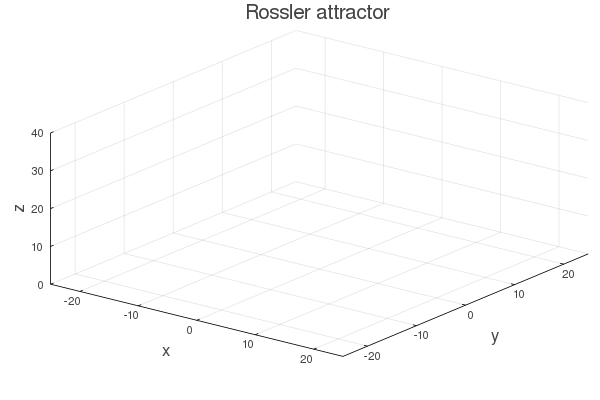

In [2]:
a,b,c = 0.1, 0.1, 14

f  = rossler_f(a,b,c)
x₀ = [0.0; 13; 1.0]

N = 2000
Δt = 0.01

plt = plot3d(
    1,
    xlim = (-25, 25),
    ylim = (-25, 25),
    zlim = (0, 40),
    camera = (40,60),
    title = "Rossler attractor",
    legend = :none,
    xlabel = "x", ylabel = "y", zlabel = "z",
    #aspect_ratio=:equal
    #marker = 1,
)

x = copy(x₀)

@gif for n =1:3000
    rk4!(f, x, Δt, 2)
    push!(plt, x[1], x[2], x[3])
    end every 20


### 3.  The equilibrium near the origin, 2d linearized dynamics

Again, the dynamics are
\begin{align*}
\dot{x} &= -y-z\\
\dot{y} &= x + ay \\
\dot{z} &= b + z(x-c)
\end{align*}

We find the equilibria by setting $\dot{x} = \dot{y} = \dot{z} = 0$ 
\begin{align*}
0 &= -y-z\\
0 &= x + ay \\
0 &= b + z(x-c)
\end{align*}

Solving for $(x,y,z)$, we find that for $0 < a < 4$, the system has two equilibria at $x = (c \pm \sqrt{c^2-4ab})/2$, $y=-x/a$, and $z=x/a$. 

For $0 < a,b \ll 1$ and $1 \ll c$, one of these equilibria is near the origin, and one is very far away.

In [3]:
function rossler_eqbs(a,b,c)
    x0 = (c - sqrt(c^2-4a*b))/2
    x1 = (c + sqrt(c^2-4a*b))/2
    return ([x0; -x0/a; x0/a], [x1; -x1/a; x1/a])
end

a,b,c = 0.1, 0.1, 14
(xstar0, xstar1) = rossler_eqbs(a,b,c)

@show xstar0
@show xstar1;

xstar0 = [0.0007143221611531914, -0.007143221611531914, 0.007143221611531914]
xstar1 = [13.999285677838847, -139.99285677838847, 139.99285677838847]


You can get a pretty good picture of dyamics near the origin by dropping the nonlinear term $zx$ from the $\dot{z}$ equation, noting that the $z$ dynamics $\dot{z} = -c z + b$ are uncoupled from $x$ and $y$ and strongly damped since $1 \ll c$. Thus $z$ rapidly appoaches the constant value $z=b/c \ll 1$. Then treat the $z$ term in the $\dot{x}$ equation as a small constant, which just introduces a small offset in $x$ from the origin. Dropping this offset, we get a rough model of $x,y$ dynamics around the origin as 

\begin{align*}
\dot{x} &= -y\\
\dot{y} &= x + ay\\
\end{align*}

Since $0< a \ll 1$, this will be close to an oscillator governed by the matrix $[0, -1; 1, 0]$, which has eigenvalues $\pm i$ and eigenvectors $[1, 0]$ and $[0, 1]$. 

In [4]:
lambda, v = eigen([0 -1; 1 0])
@show lambda
@show v[:,1]
@show v[:,2];

lambda = Complex{Float64}[0.0 - 1.0im, 0.0 + 1.0im]
v[:, 1] = Complex{Float64}[0.7071067811865475 - 0.0im, 0.0 + 0.7071067811865475im]
v[:, 2] = Complex{Float64}[0.7071067811865475 + 0.0im, 0.0 - 0.7071067811865475im]


But the small positive value of $a$ in the linearization adds a weak positive real part to the eigenvalues.

In [5]:
a,b,c = 0.1, 0.1, 14

lambda, v = eigen([0 -1; 1 a])
@show lambda[1]
@show lambda[2]
@show v[:,1]
@show v[:,2];

lambda[1] = 0.04999999999999996 - 0.9987492177719088im
lambda[2] = 0.04999999999999996 + 0.9987492177719088im
v[:, 1] = Complex{Float64}[0.7071067811865475 - 0.0im, -0.035355339059327306 + 0.7062223445912768im]
v[:, 2] = Complex{Float64}[0.7071067811865475 + 0.0im, -0.035355339059327306 - 0.7062223445912768im]


This explains the slowly expanding circulation around origin (nearly) that we observed in the 3d animation.
Note that the imaginary part is still nearly 1, so that the period of oscillation is about $T=2\pi$. The growth
per period is then about $\exp(Re(\lambda) T)$, or 

In [6]:
exp(0.05*2*pi)

1.369107770624847

Let's show that again in a 2d $x,y$ view, starting from the origin.

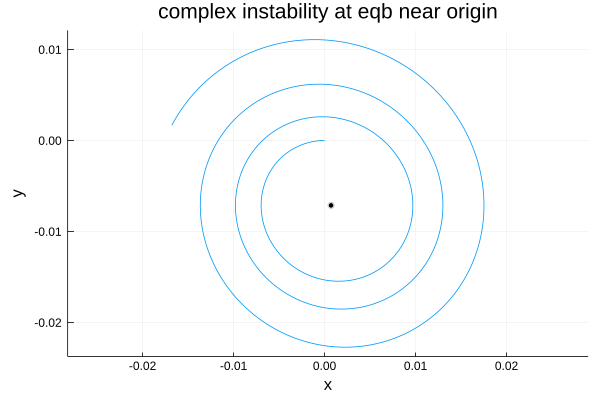

In [7]:
x₀ = [0.0; 0.0; 0.0]

N = 2000
Δt = 0.01
t₀ = 0.0

f  = rossler_f(a,b,c)
t,x = rk4(f, x₀, Δt, N)

plot(x[:,1], x[:,2], label="")
scatter!([xstar0[1]], [xstar0[2]], markercolor=:black, label="")
plot!(xlabel="x",ylabel="y",aspect_ratio=:equal)
plot!(title="complex instability at eqb near origin")

37% growth per period looks about right.

### 4. Linearized dynamics in 3d

The 2d linearization above relies on a separation of time scales between the $z$ and the $x,y$ dynamics and
ignoring the offset of the equilibrium from the origin. Let get a more accurate picture by computing the eigenvalues 
of $Df$ at fixed point. We should have one complex pair about $\lambda \approx 0.05 \pm i$ with eigenvectors nearly 
in the $x,y$ plane, and one real $\lambda \approx c = -14$ nearly aligned with the $z$ axis.

In [8]:
f = rossler_f(a,b,c)
Df(f, xstar0)

3×3 Array{Float64,2}:
 0.0         -1.0   -1.0
 1.0          0.1    0.0
 0.00714322   0.0  -13.9993

In [9]:
lambda, v = eigen(Df(f, xstar0))

Eigen{Complex{Float64},Complex{Float64},Array{Complex{Float64},2},Array{Complex{Float64},1}}
values:
3-element Array{Complex{Float64},1}:
 -13.998777975653889 + 0.0im
 0.04974614887038167 - 0.9987545047819638im
 0.04974614887038167 + 0.9987545047819638im
vectors:
3×3 Array{Complex{Float64},2}:
    0.070895+0.0im     0.707113-0.0im            0.707113+0.0im
 -0.00502845+0.0im   -0.0355339+0.706207im     -0.0355339-0.706207im
    0.997471+0.0im  0.000357723+2.54308e-5im  0.000357723-2.54308e-5im

In [10]:
lambda

3-element Array{Complex{Float64},1}:
 -13.998777975653889 + 0.0im
 0.04974614887038167 - 0.9987545047819638im
 0.04974614887038167 + 0.9987545047819638im

The period of oscillation about the origin should be about $T = 2\pi/\omega$ where $\omega$ is the imaginary part of  $\lambda$.

In [13]:
T = 2pi/imag(lambda[3])

6.291020743432098

And the thickness of the attractor at its thinnest part should be about 

In [14]:
30*exp(lambda[1]*T/2)

2.2578832103594193e-18 + 0.0im

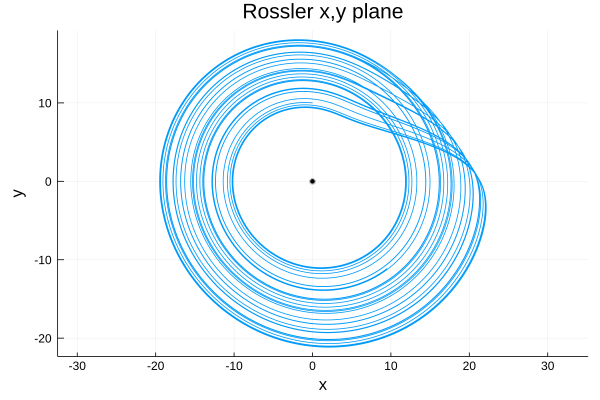

In [15]:
x₀ = [0.0; 10.0; 0.01]
N = 20001
Δt = 0.01
t₀ = 0.0

t,x = rk4(f, x₀, Δt, N)

plot(x[:,1], x[:,2], label="")
scatter!([xstar0[1]], [xstar0[2]], markercolor=:black, label="")
plot!(xlabel="x",ylabel="y",aspect_ratio=:equal)
plot!(title="Rossler x,y plane")

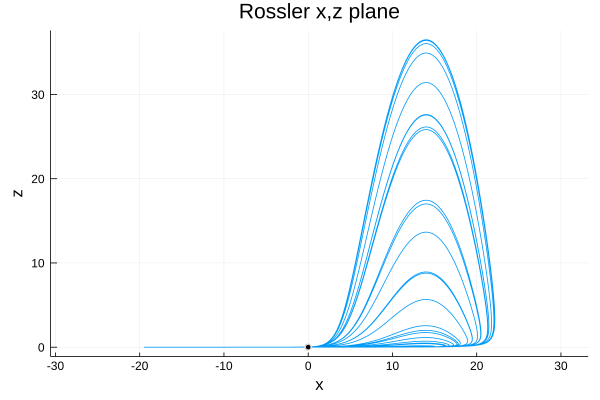

In [16]:
plot(x[:,1], x[:,3], label="")
scatter!([xstar0[1]], [xstar0[3]], markercolor=:black, label="")
plot!(xlabel="x",ylabel="z",aspect_ratio=:equal)
plot!(title="Rossler x,z plane")

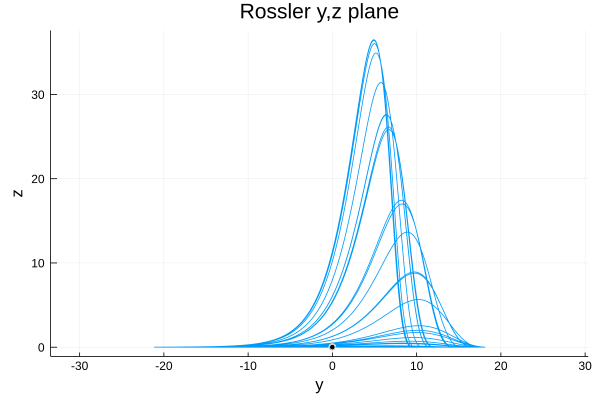

In [17]:
plot(x[:,2], x[:,3], label="")
scatter!([xstar0[2]], [xstar0[3]], markercolor=:black, label="")
plot!(xlabel="y",ylabel="z",aspect_ratio=:equal)
plot!(title="Rossler y,z plane")

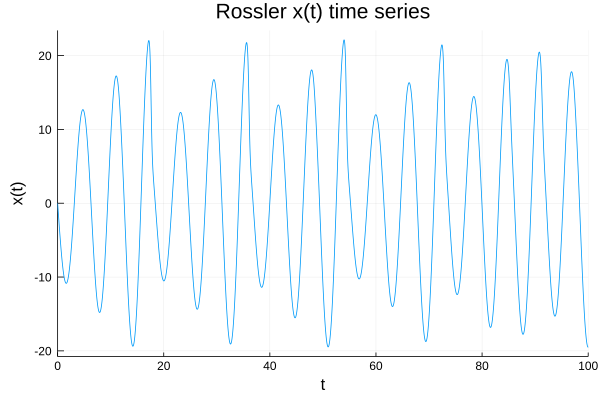

In [18]:
plot(t, x[:,1], label="")
plot!(xlim=(0,100), xlabel="t", ylabel="x(t)")
plot!(title="Rossler x(t) time series")

## Sensitive dependence on initial conditions

Plotting two nearby initial conditions and how they diverge in time.

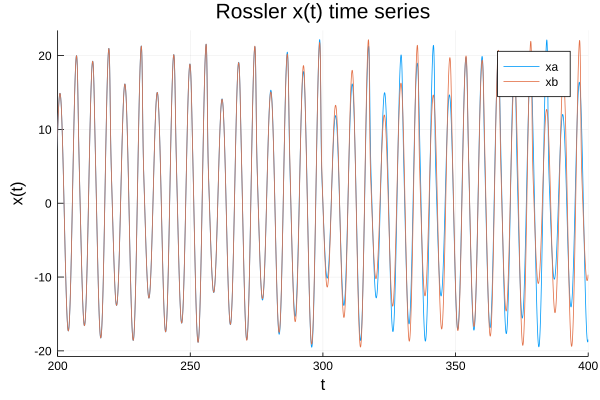

In [23]:
eps = 1e-9
xa₀ = [0.0; 10.0; 0.01]
xb₀ = xa₀ + eps*randn(3)

N = 40000
Δt = 0.01
t₀ = 0.0

a,b,c = 0.1, 0.1, 14
f  = rossler_f(a,b,c)

t,xa = rk4(f, xa₀, Δt, N)
t,xb = rk4(f, xb₀, Δt, N)

plot(t, xa[:,1], label="xa")
plot!(t, xb[:,1], label="xb")
plot!(xlabel="t", ylabel="x(t)")
plot!(xlim=(200,400))
plot!(title="Rossler x(t) time series")

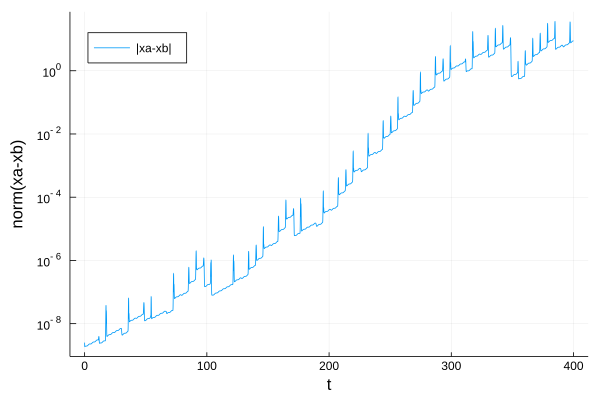

In [26]:
xdiff = xa - xb
xnorm = mapslices(x -> norm(x), xdiff, dims=2)

plot(t, xnorm, label="|xa-xb|", yaxis=:log, legend=:topleft)
plot!(xlabel="t",ylabel="norm(xa-xb)")

## Period-doubling bifurcations under increasing c

In [31]:
function plottrajectory(;c=4, ttl="")
    a,b = 0.10, 0.1
    
    f = rossler_f(a,b,c)

    N₀ = 100000
    N = 20000
    Δt = 0.01
    t₀ = 0.0

    xstar0, xstar1 = rossler_eqbs(a,b,c)
    
    x₀ = 1.01*xstar0
    t,x = rk4(f, x₀, Δt, N₀)
    t,x = rk4(f, x[N₀,:], Δt, N)

    #@show x[end,:]
    plot(x[:,1], x[:,2], label="")
    scatter!([xstar0[1]], [xstar0[2]], markercolor=:black, label="")
    plot!(xlabel="x",ylabel="y",aspect_ratio=:equal)
    plot!(xlim=(-30,30),ylim=(-22,22))
    plot!(title="Rossler, c=$c, $ttl")
end

plottrajectory (generic function with 1 method)

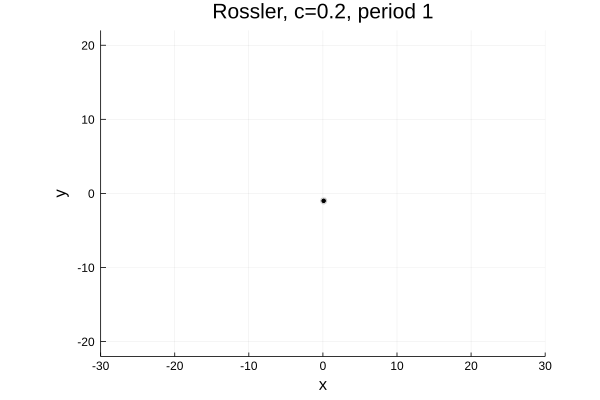

In [32]:
plottrajectory(c=0.2, ttl="period 1")

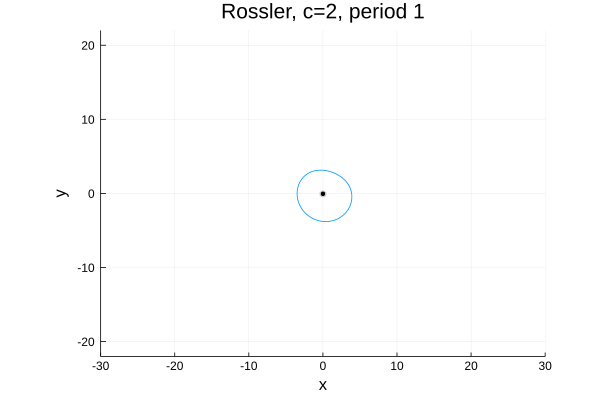

In [33]:
plottrajectory(c=2, ttl="period 1")

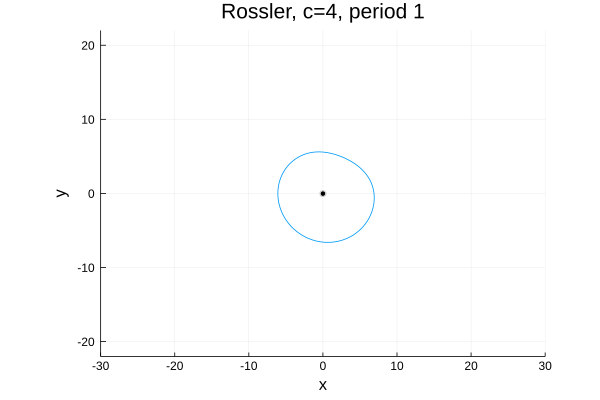

In [34]:
plottrajectory(c=4, ttl="period 1")

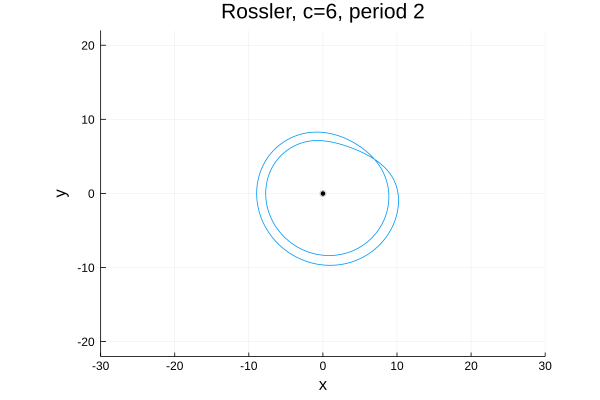

In [35]:
plottrajectory(c=6, ttl="period 2")

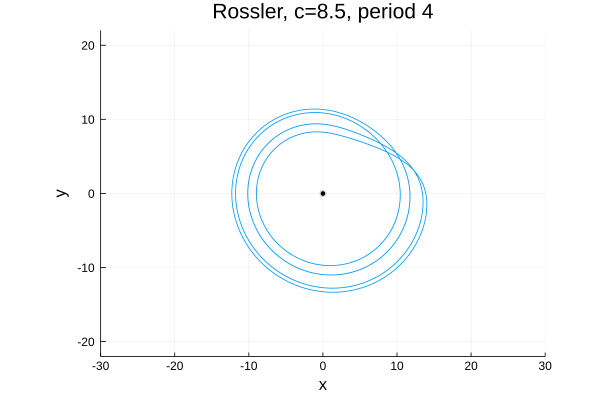

In [36]:
plottrajectory(c=8.5, ttl="period 4")

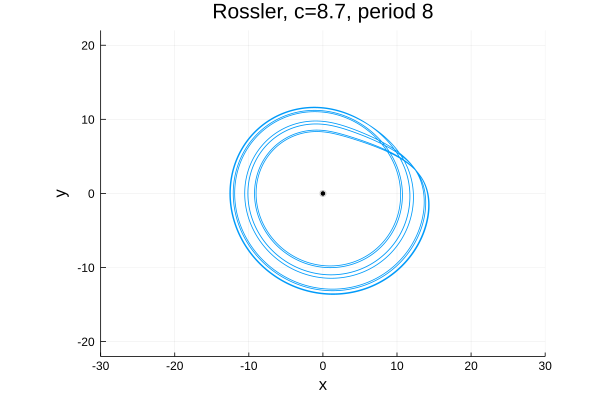

In [37]:
plottrajectory(c=8.7, ttl="period 8")

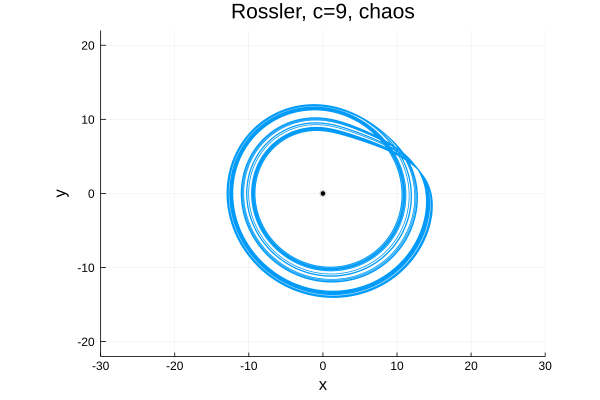

In [38]:
plottrajectory(c=9, ttl="chaos")

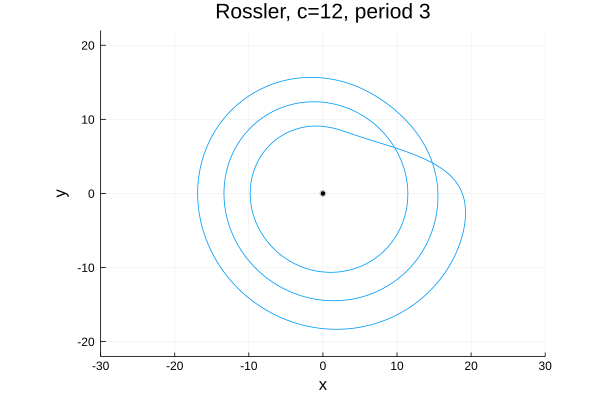

In [39]:
plottrajectory(c=12, ttl="period 3")

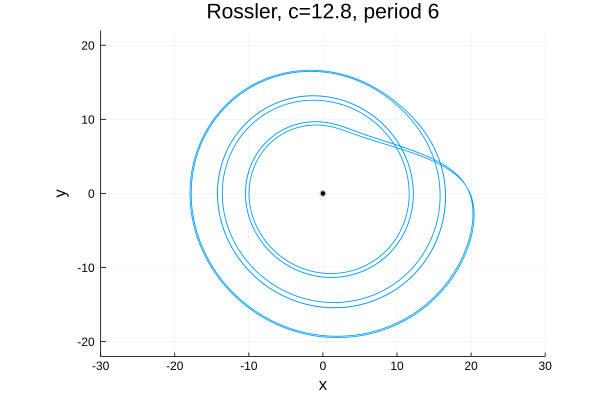

In [40]:
plottrajectory(c=12.8, ttl="period 6")

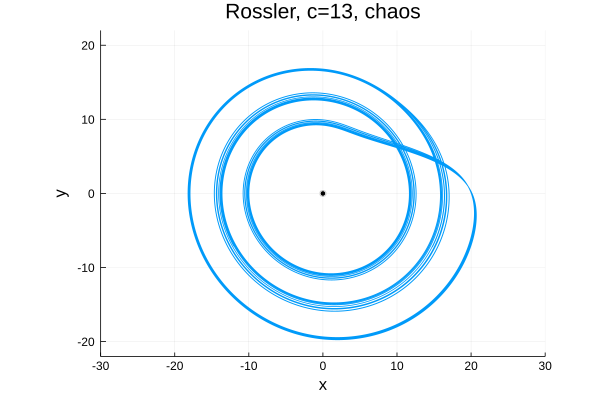

In [41]:
plottrajectory(c=13, ttl="chaos")

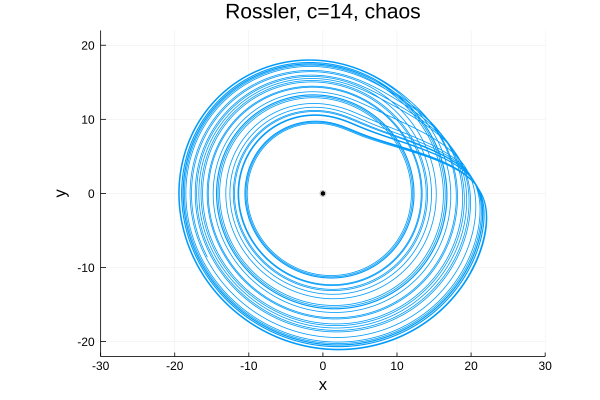

In [42]:
plottrajectory(c=14, ttl="chaos")

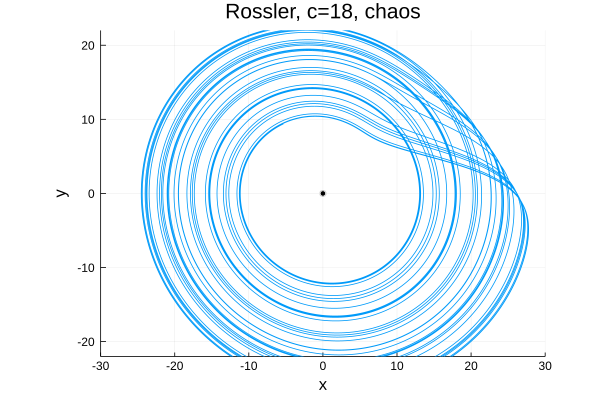

In [43]:
plottrajectory(c=18, ttl="chaos")

┌ Info: Saved animation to 
│   fn = /home/gibson/professional/teaching/747/notebooks/anim_fps15.gif
└ @ Plots /home/gibson/.julia/packages/Plots/qZHsp/src/animation.jl:98


Plots.AnimatedGif("/home/gibson/professional/teaching/747/notebooks/anim_fps15.gif")
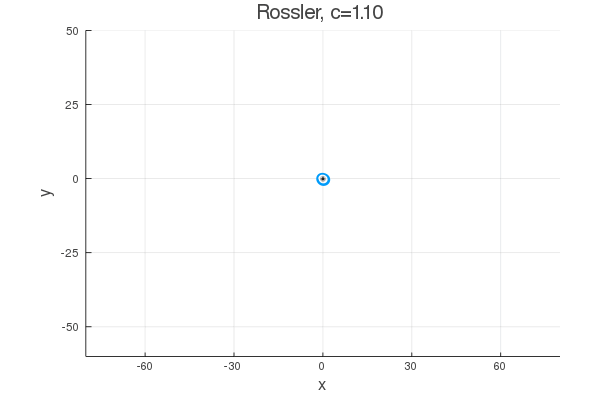

In [44]:
using Printf

# a version of Rossler dynamics where c grows slowly in time, dc/dt = k
function rossler_bif_f(a,b,k)
    function f(x)
        [-x[2]-x[3]; x[1] + a*x[2]; b + x[3]*(x[1]-x[4]); k]
    end
    return f
end

a,b = 0.1, 0.1
x₀ = [0.0; 1.0; 0.0]

c = 1.0
cmax = 28.0
N = 400

anim = @animate for n=1:N
    c = c + 0.1
    f  = rossler_f(a,b,c)
    
    N = 10000
    Δt = 0.02
    t₀ = 0.0

    xstar0, xstar1 = rossler_eqbs(a,b,c)
    
    t,x = rk4(f, x₀, Δt, N)

    x₀ .= x[end,:]
    #@show x[end,:]
    
    t=1000:N
    plot(x[t,1], x[t,2], label="")
    scatter!([xstar0[1]], [xstar0[2]], markercolor=:black, label="")
    plot!(xlabel="x",ylabel="y",aspect_ratio=:equal)
    plot!(xlim=(-80,80),ylim=(-60,50))
    
    cstr = @sprintf("%.2f",c)
    plot!(title="Rossler, c=$cstr")
    
    end every 1

gif(anim, "anim_fps15.gif", fps = 10)




┌ Info: Saved animation to 
│   fn = /home/gibson/professional/teaching/747/notebooks/anim3.gif
└ @ Plots /home/gibson/.julia/packages/Plots/qZHsp/src/animation.jl:98


Plots.AnimatedGif("/home/gibson/professional/teaching/747/notebooks/anim3.gif")
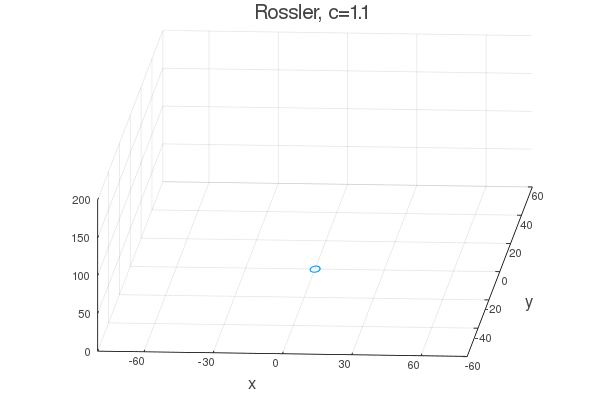

In [46]:
using Printf

# a version of Rossler dynamics where c grows slowly in time, dc/dt = k
function rossler_bif_f(a,b,k)
    function f(x)
        [-x[2]-x[3]; x[1] + a*x[2]; b + x[3]*(x[1]-x[4]); k]
    end
    return f
end

a,b = 0.1, 0.1
x₀ = [0.0; 1.0; 0.0]

c = 1.0
cmax = 28.0
N = 400

anim = @animate for n=1:N
    c = c + 0.1
    f  = rossler_f(a,b,c)
    
    N = 20000
    Δt = 0.01
    t₀ = 0.0

    xstar0, xstar1 = rossler_eqbs(a,b,c)
    
    t,x = rk4(f, x₀, Δt, N)

    #nrm = mapslices(x -> norm(x), x, dims=2)
    #m, i = findmax(nrm)
    #i[1]
    x₀ .= x[end,:]
    #@show x[end,:]
    
    t=4000:1:N
    plot(x[t,1], x[t,2], x[t,3], label="")
    #scatter!([xstar0[1]], [xstar0[2]], markercolor=:black, label="")
    plot!(xlabel="x",ylabel="y",zlabell="z", aspect_ratio=:equal, camera=(10,60))
    plot!(xlim=(-80,80),ylim=(-60,60),zlim=(0,200))
    
    cstr = @sprintf("%.1f",c)
    plot!(title="Rossler, c=$cstr")
    
    end every 1

gif(anim, "anim3.gif", fps = 10)


